In [1]:
DATA_DIR = '/lustre/groups/ml01/workspace/louis.kuemmerle/projects/A1/data2/' # "./../"
DATA_VERSION = 'oct22'
RESULTS_DIR = '/lustre/groups/ml01/workspace/louis.kuemmerle/projects/A1/results/'
SHAM = True

########################################################################################
sham_str = '_wSham' if SHAM else ''

### imports

In [2]:
import os
import pandas as pd

import numpy as np
import itertools
import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt

import scanpy as sc
import anndata as ann
import scvelo as scv
import cellrank as cr

import scipy as sci
from scipy import sparse
from scipy.sparse import csr_matrix, issparse
from matplotlib import rcParams
from matplotlib import colors

sc.settings.verbosity = 3
sc.logging.print_header()#print_versions()
print(f"scvelo=={scv.__version__}")
print(f"cellrank=={cr.__version__}")

scanpy==1.6.1 anndata==0.7.5 umap==0.4.6 numpy==1.23.2 scipy==1.6.0 pandas==1.2.0 scikit-learn==0.24.0 statsmodels==0.12.1 python-igraph==0.8.3 louvain==0.7.0 leidenalg==0.8.3
scvelo==0.2.3
cellrank==1.1.0


### functions

In [3]:
def plot_subset_umap(adata,group,**kwargs):
    a = adata[~np.isnan(adata.obsm[f'X_umap_{group}']).any(axis=1)]
    em = sc.pl.embedding(basis=f'X_umap_{group}', adata=a, **kwargs)
        
def plot_subset_umap_single_panel(adata,group,legend_dotsize=100,save=False,**kwargs):
    a = adata[~np.isnan(adata.obsm[f'X_umap_{group}']).any(axis=1)]
    em = sc.pl.embedding(basis=f'X_umap_{group}', adata=a, **kwargs, ax=plt.gca(), show=False)
    lgnd = em.get_legend()
    for handle in lgnd.legendHandles:
        handle._sizes = [legend_dotsize]
    if save:
        plt.gcf().savefig(save, bbox_inches = "tight", transparent=True)
    plt.show()
    
def umap_single_panel(adata,legend_dotsize=100,save=False,**kwargs):
    em = sc.pl.umap(adata=adata, **kwargs, ax=plt.gca(), show=False)
    lgnd = em.get_legend()
    for handle in lgnd.legendHandles:
        handle._sizes = [legend_dotsize]
    if save:
        plt.gcf().savefig(save, bbox_inches = "tight", transparent=True)
    plt.show()

### load data

In [4]:
adata = sc.read(DATA_DIR+f'cellxgene_{DATA_VERSION}{sham_str}_umaps.h5ad')
adata.obs['region'] = adata.obs['region'].cat.rename_categories({'Skull': 'Calvaria'})

In [5]:
# Get an adata with random order via adata[random_order]
np.random.seed(0)
random_order=np.random.permutation(list(range(adata.shape[0])))

In [6]:
umap_group_to_dotsize = {
    'B cells'          :60,
    'DC'               :140,
    'NKT'              :80,
    'basophil'         :240,
    'brain cells'      :150,
    'erythroid'        :22,
    'macrophage'       :60,
    'monocytes'        :60,
    'neutrophils'      :26,
    'other'            :1000,
    'progenitors'      :70,
    'structural cells' :60,
}

In [7]:
plt.rcParams['figure.dpi'] = 100
plt.rcParams['savefig.dpi'] = 150
rcParams['figure.figsize']= (10,10)

SMALL_SIZE = 23 #17
MEDIUM_SIZE = 25 #19
BIGGER_SIZE = 27 #21

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

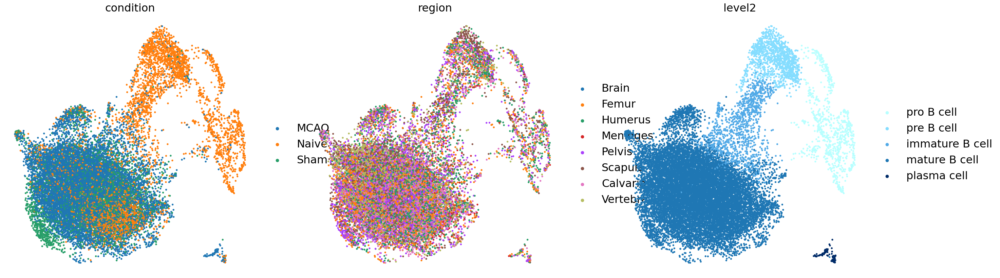

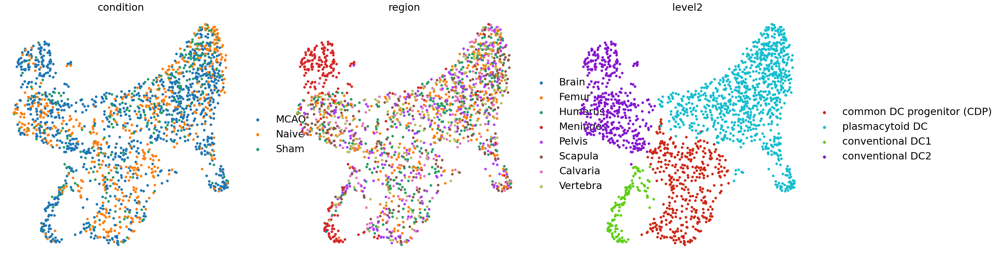

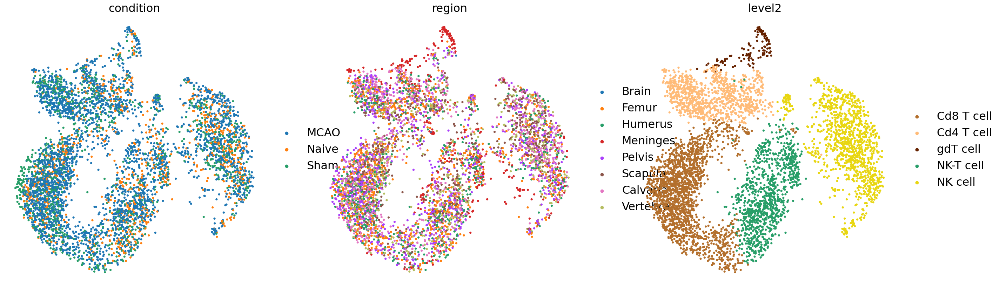

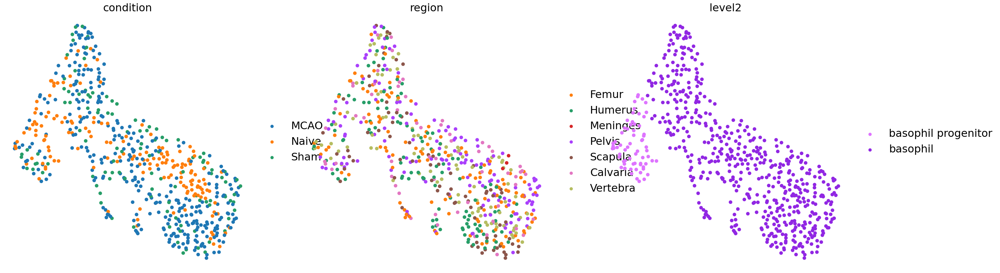

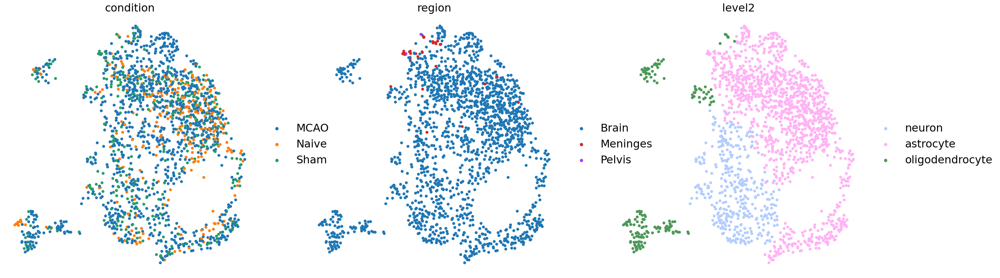

...

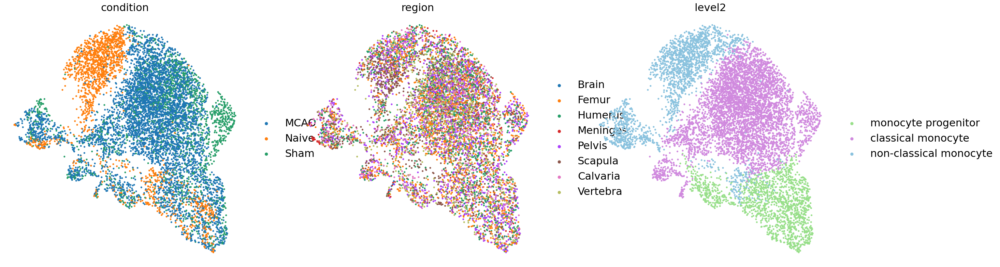

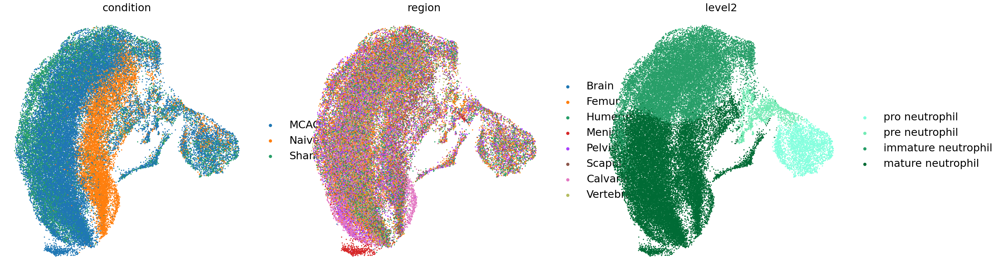

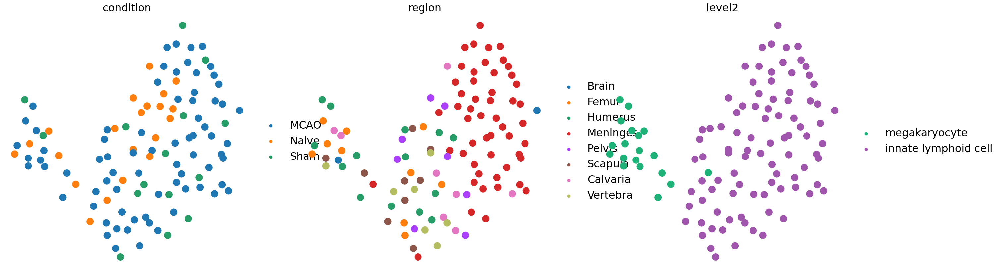

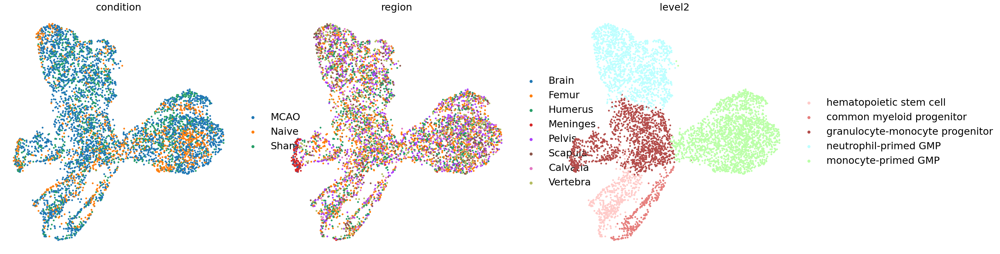

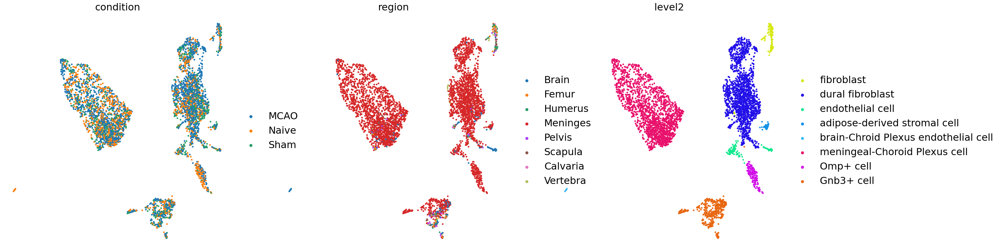

In [8]:
for group in adata.uns['umap_groups']:
    plot_subset_umap(
        adata[random_order],group,color=['condition','region','level2'],
        size=umap_group_to_dotsize[group], frameon=False
    )

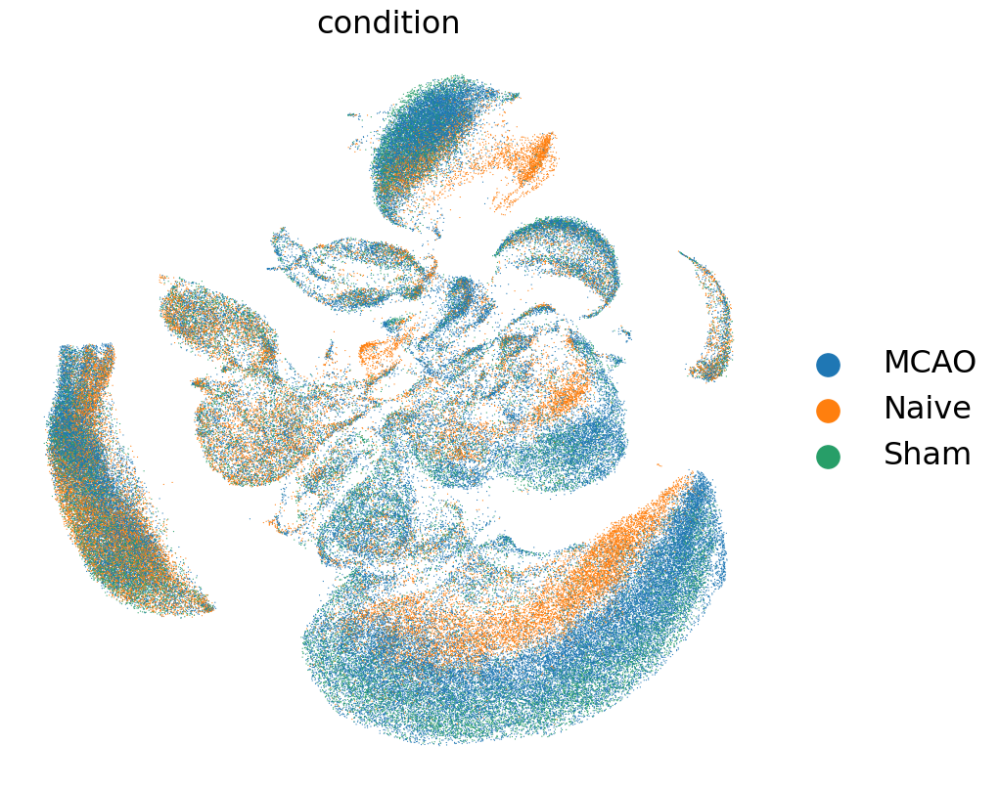

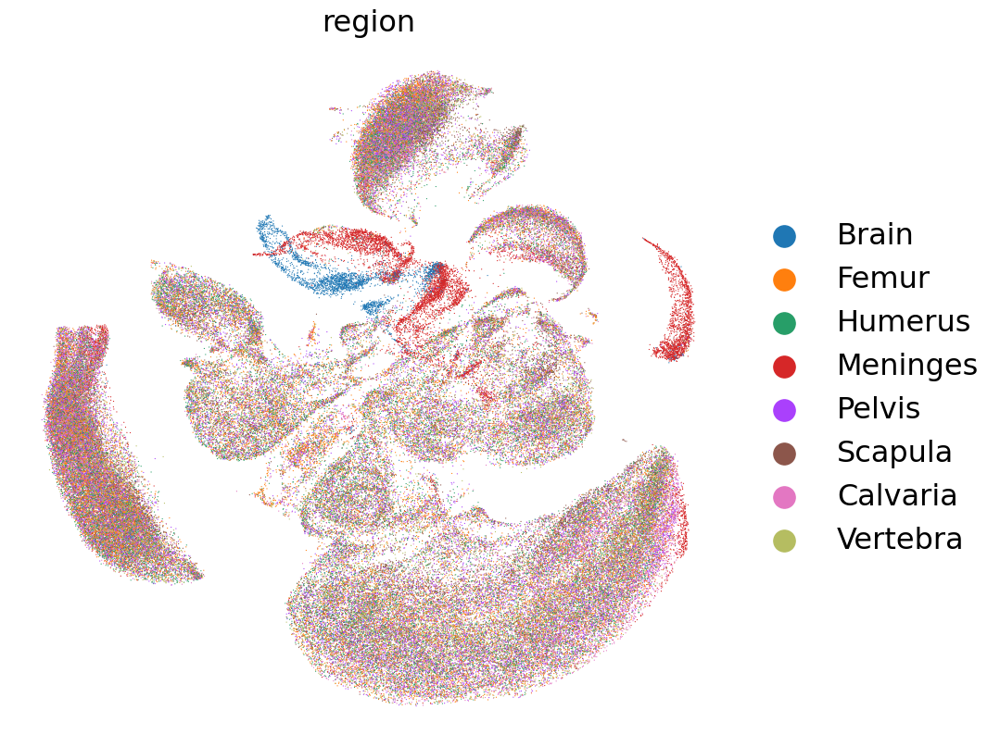

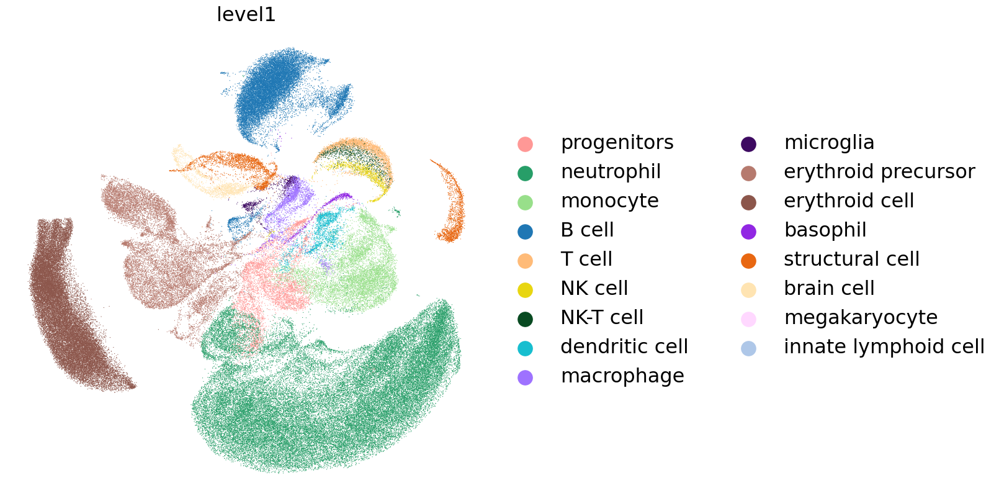

In [9]:
for key in ['condition','region','level1']:
    umap_single_panel(
        adata[random_order],color=key, size=3, legend_dotsize=280,
        save=f"./figures/umaps/level1_{key}.pdf",
        frameon=False
    )

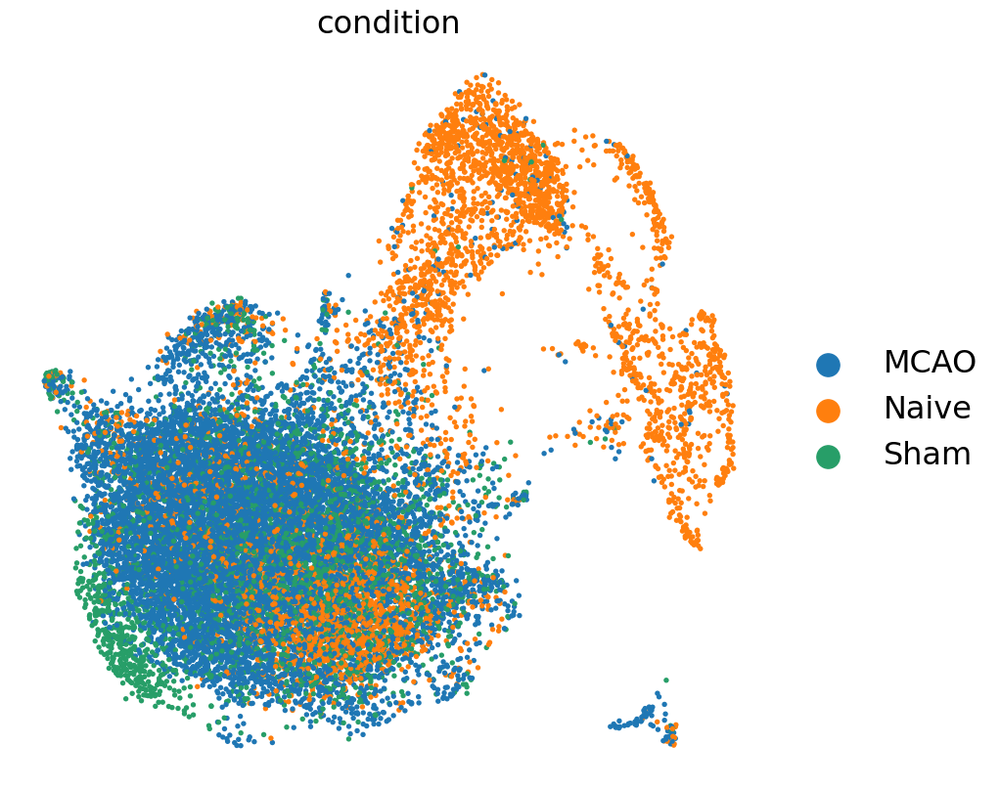

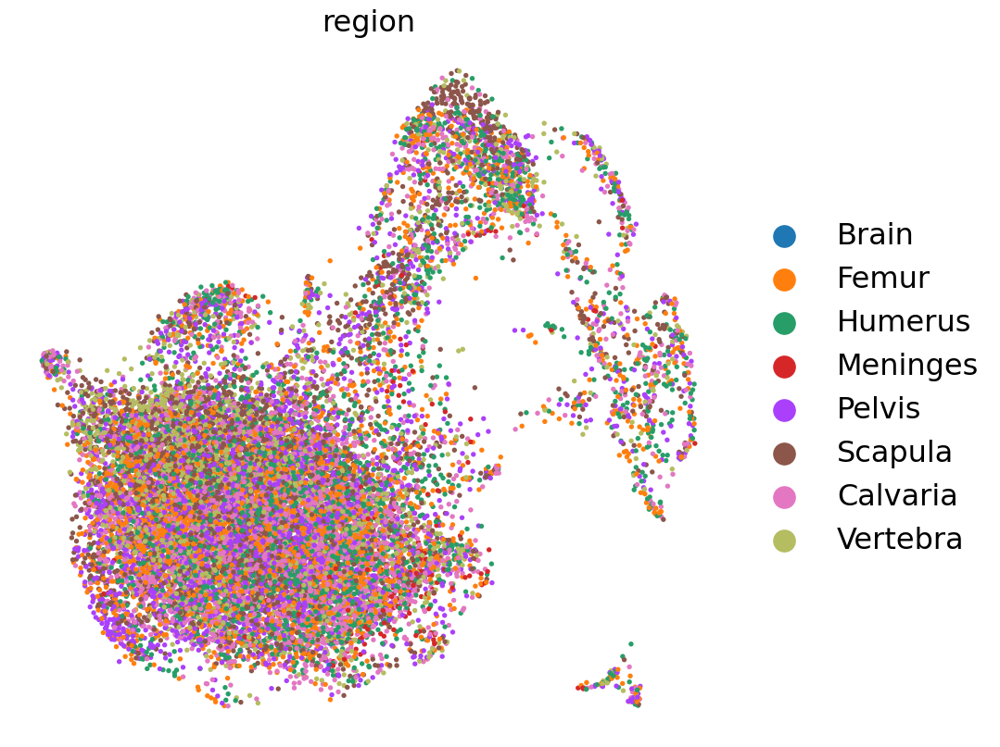

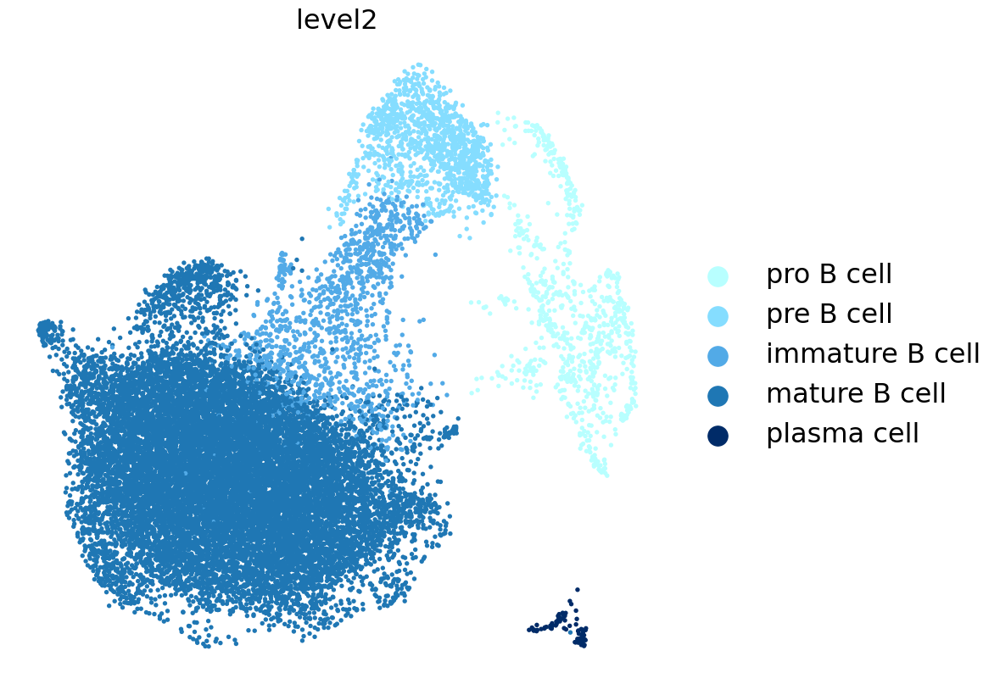

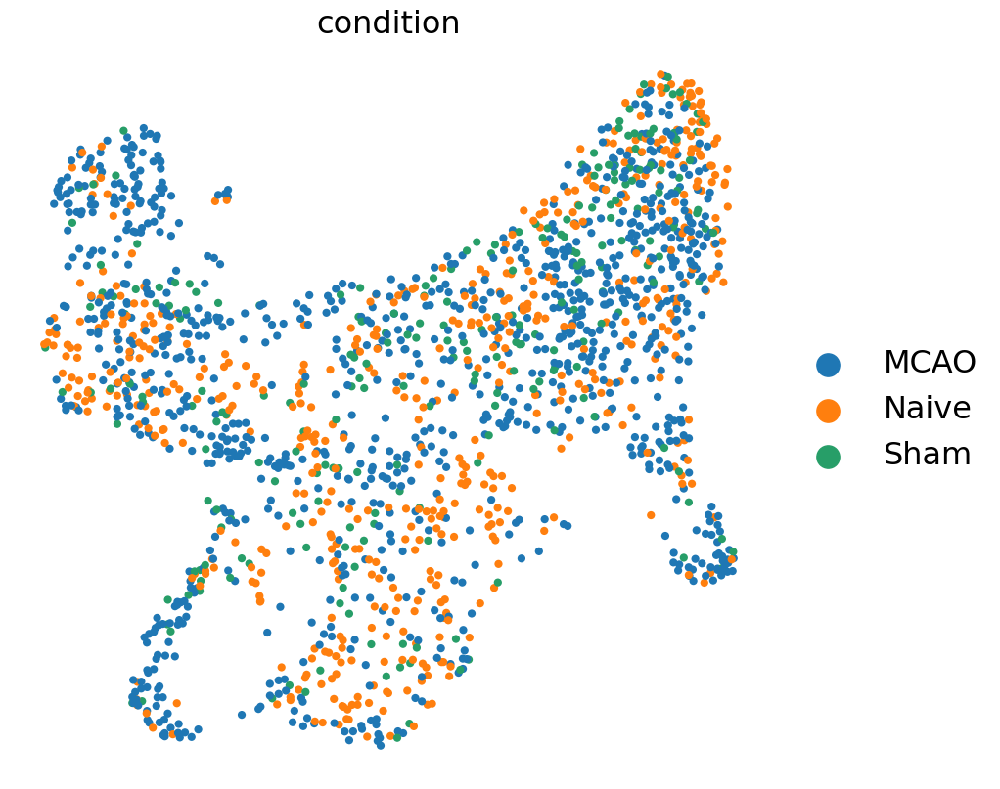

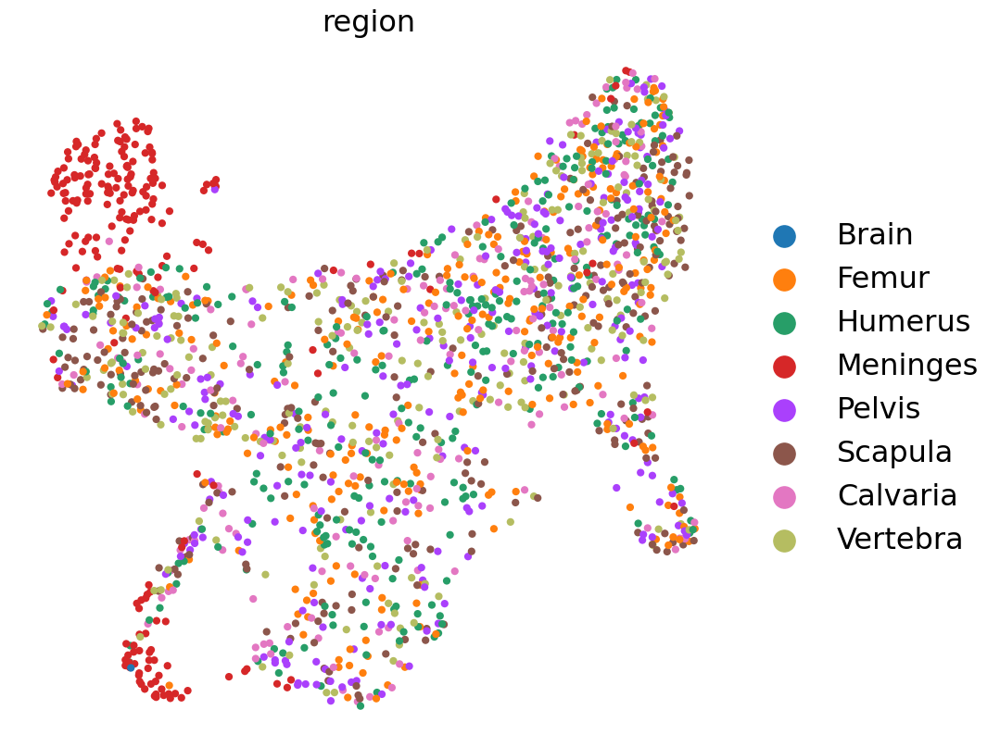

...

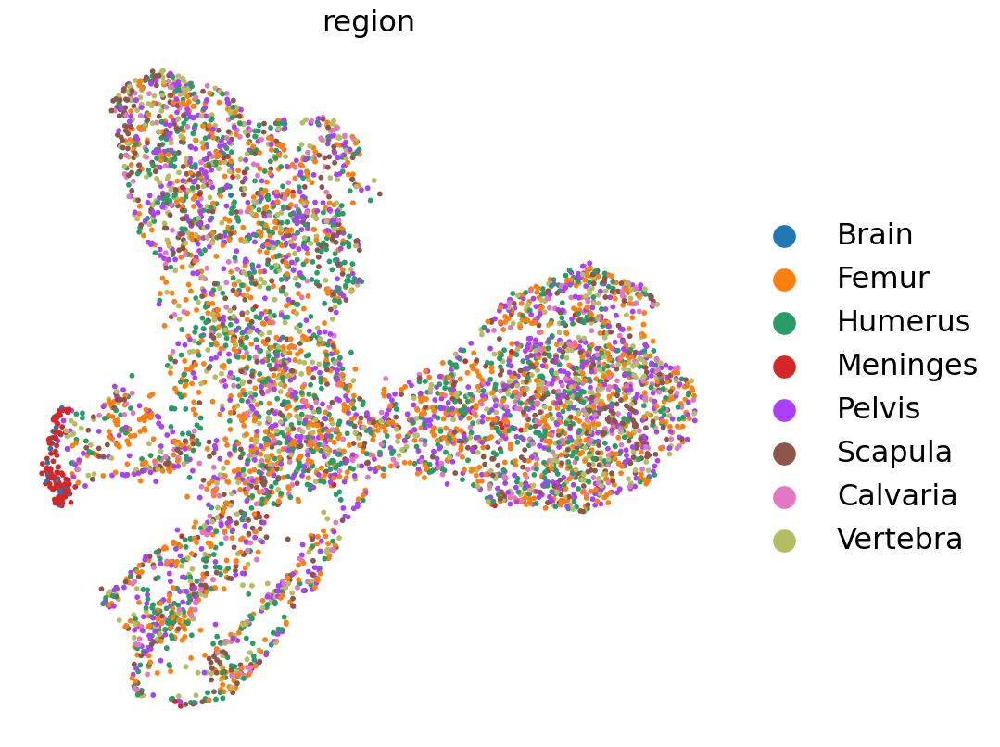

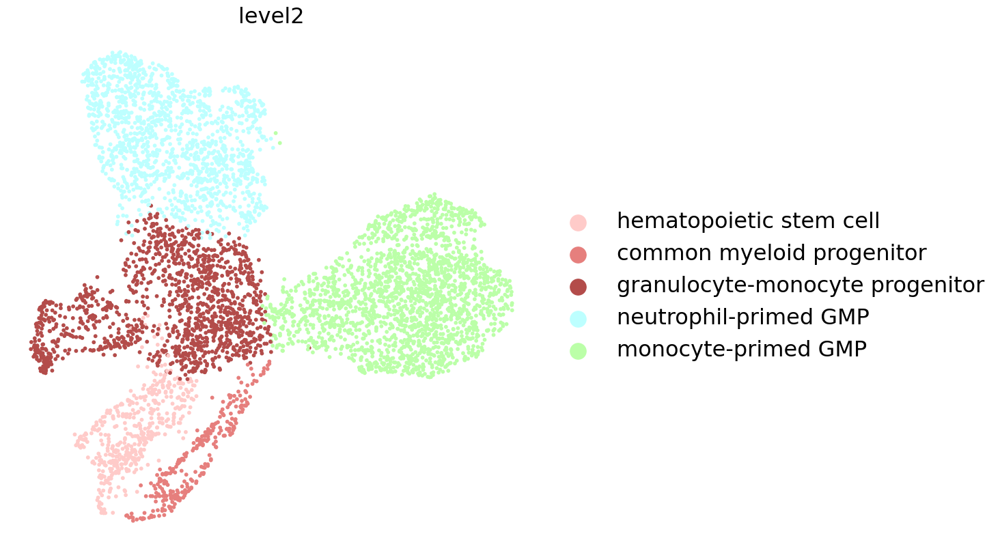

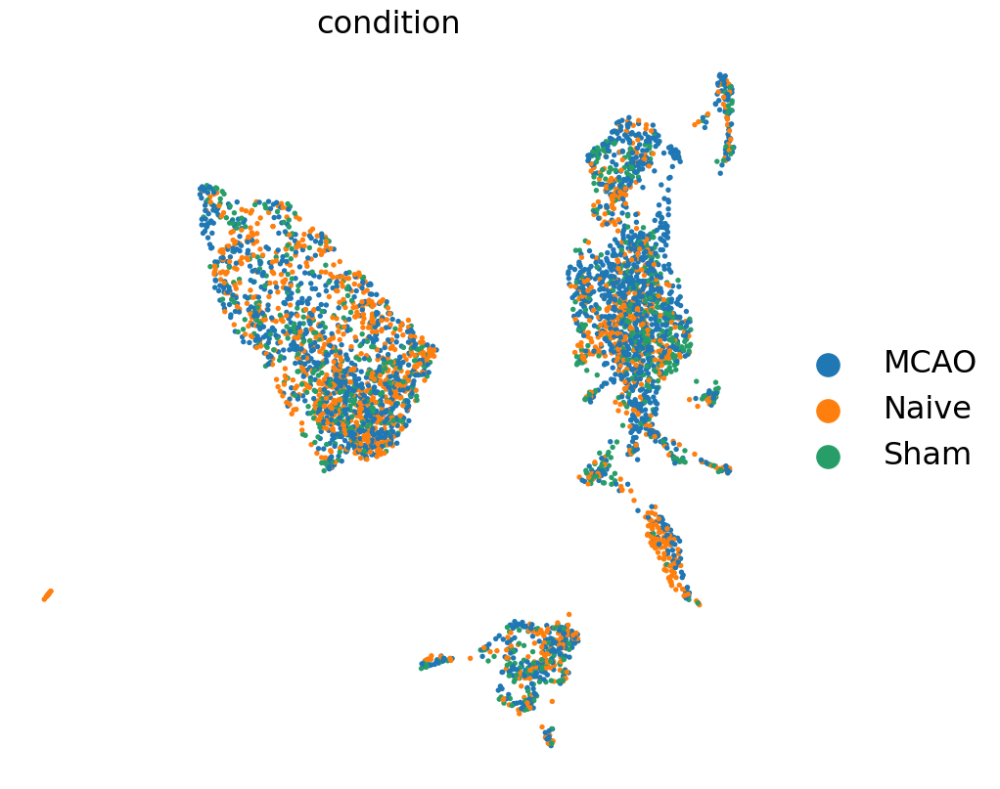

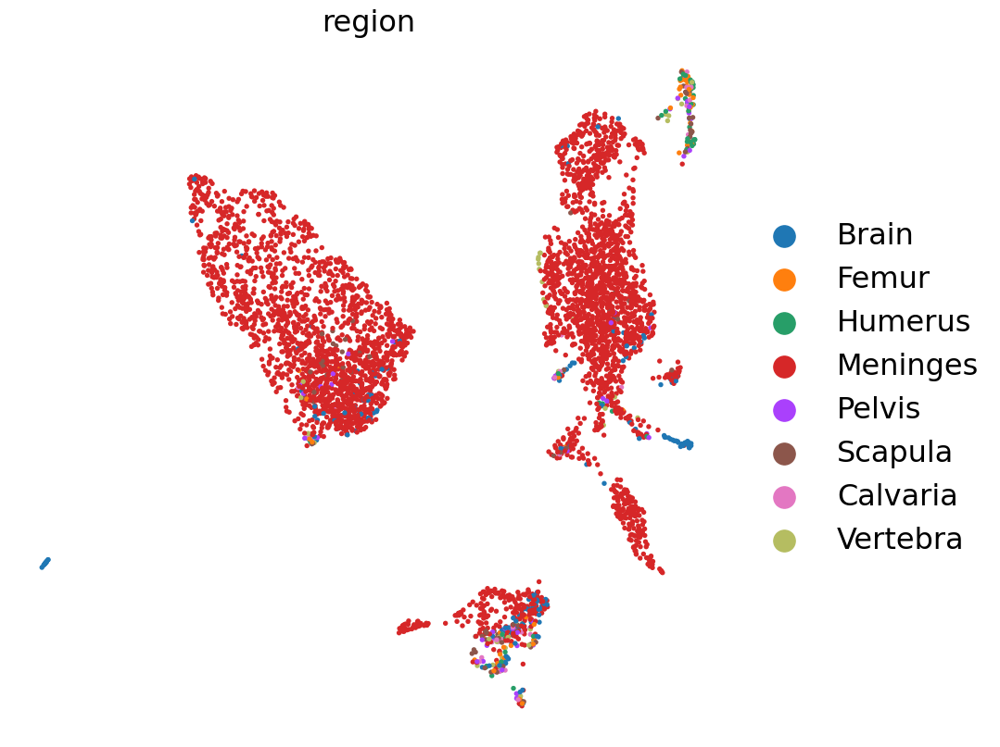

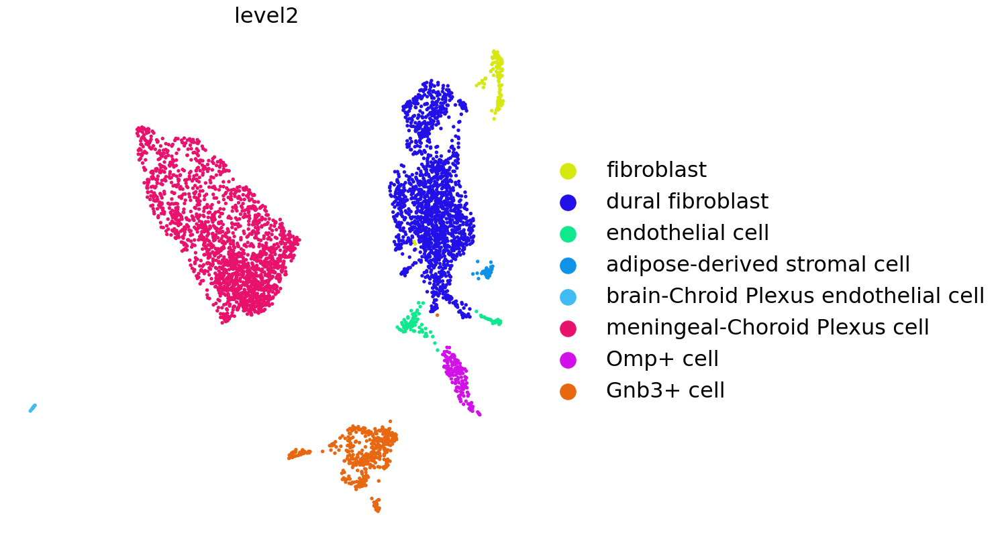

In [10]:
for group in adata.uns['umap_groups']:
    
    for key in ['condition','region','level2']:

        plot_subset_umap_single_panel(
            adata[random_order],group,color=key,legend_dotsize=280,
            size=umap_group_to_dotsize[group],frameon=False,
            save=f"./figures/umaps/level2_{group}_{key}.pdf"
        )